## Multi-Epoch Spectral Fitting (MESFit)

### MESFit is a code to perform the spectral decomposition of AGN in time-series analysis. 

Here we give an example of 50-epoch SDSS-RM quasar to extract the information from the time series spectroscopies. The information including the Mean (RMS) spectrum, continuum (emission line) light curves, host stellar velocity dispersion, radial velocity shift of broad emission lines,  and some basic continuum and line properties obtained from QSOFit. 

#### Main procedures:
#### 1) Coadd spectrum 
Convert the spectra to rest-frame and coadd the spectra to get the mean and rms spectrum. Note that the rms spectrum is the total flux rms spectrum, we will produce the emission line only rms spectrum in the last step.

#### 2) Calibration 
Calibration with narrow lines (e.g., [OIII]) assuming the narrow line flux is constant during the monitoring. Nomorlized the multi-epoch spectra with **A * (GaussFilter(flux, sigma) + yshift)** , where A is the scale factor, sigma is the width of the Gaussian Filter to cancel the effects of different seeings and slits, and yshift is the continuum variability around the narrow line. We did not use any redshift corrections since the most time, they are unnecessary. 

#### 3) Decompose mean spectrum
Fit the mean spectrum with QSOFit to obtain the host galaxy component, and narrow lines since these two components are usually constant. 

#### 4) Fit the host with pPXF
Use pPXF to fit the host component to get the stellar velocity dispersion (or properties of the stellar population and star-formation history).

#### 5) Decompose nightly spectrum
Subtract the same host component from the nightly spectrum to perform the spectral decomposition with fixed all narrow emission line profiles. Save the fitting results to MESFit_results.fits

#### 6) Exhibit the results
With the MESFit results, we can check the continuum and line light curves

#### 7) Obtain the emission line only rms spectrum
With the broad emission line the only spectrum, we are able to coadd the rms spectrum for any broad line. 

In [1]:
%matplotlib inline
#%matplotlib notebook
import glob, os,sys,timeit
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
from sfdmap2 import sfdmap
import pandas as pd
from scipy import interpolate
# from kapteyn import kmpfit
from astropy.io import fits
from astropy.cosmology import FlatLambdaCDM
from astropy.table import Table
from PyAstronomy import pyasl
import warnings
import matplotlib.backends.backend_pdf as bpdf
sys.path.append('../')
import pyqsofit
from pyqsofit.PyQSOFit import QSOFit
from pyqsofit.MESFit import MESFit
from scipy.ndimage import gaussian_filter1d
import matplotlib as mpl
warnings.filterwarnings("ignore")
mpl.rcParams['axes.linewidth'] = 1.5
mpl.rcParams['xtick.labelsize'] =20
mpl.rcParams['ytick.labelsize'] =20
mpl.rcParams['axes.labelsize'] =20
mpl.rcParams['axes.titlesize'] =20



### 1 & 2 coadd mean spectrum and do the calibration. We choose a  variable source with 78 epochs from SDSS-RM RMID 017 (ra, dec: 213.35116, 53.09084) with z = 0.456 in [Dexter et al. 2019](https://arxiv.org/pdf/1906.10138.pdf) and [Shen et al. 2015](https://ui.adsabs.harvard.edu/abs/2015ApJ...805...96S/abstract)

Text(0.5, 1.0, '$\\rm [OIII]\\lambda 5007\\ Normalized\\ multi-epoch\\ spectra$')

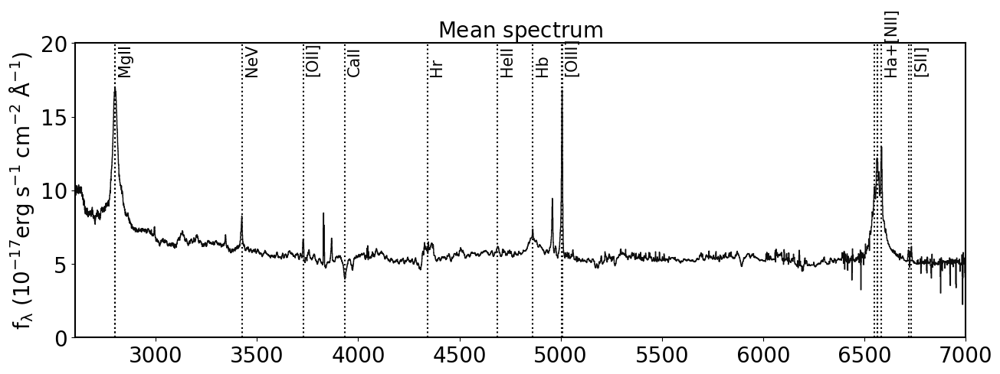

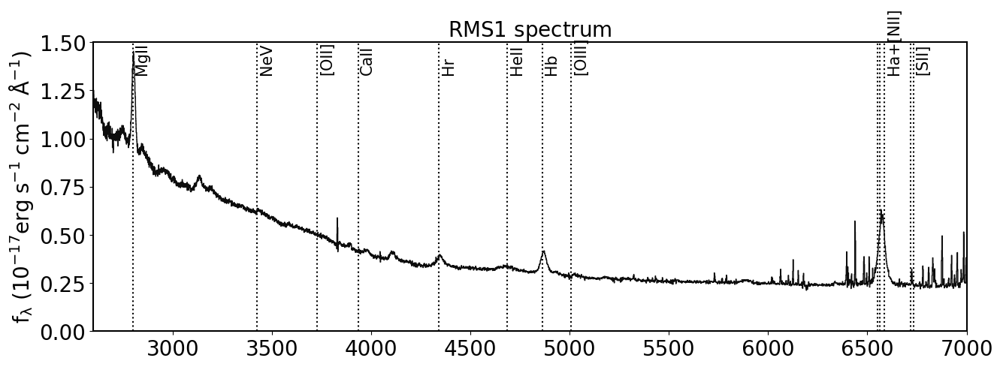

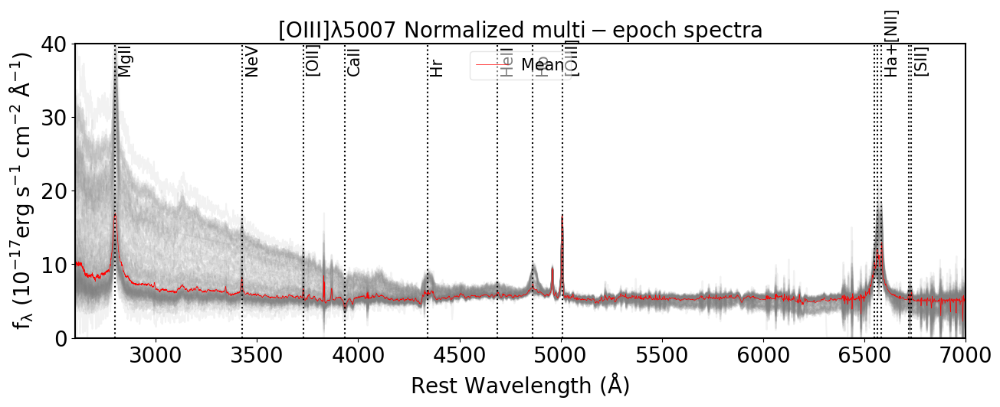

In [2]:
#path_data='./test/data/RM_017/'  # path of data
path_data=os.path.join(pyqsofit.__path__[0], '..', 'example/data/RM017')
norm_path=os.path.join(pyqsofit.__path__[0], '..', 'example/data/RM017_result') # path to save results

if not os.path.exists(norm_path):
    os.mkdir(norm_path)
    
m = MESFit(path=path_data) # MESFit will search all fits file in this path
m.Coadd_spec()                    # mean_wv rest-frame


# we will us mean spectrum as a reference to do the calibration
name = 'table'
m.normNL(norm_line_wv=5007, path = norm_path,name= name) # do the calibration with [OIII]


#_------plot results--------------------
plt.figure(figsize=(15,5))
plt.errorbar(m.mean_wv,m.mean_spec,yerr=m.mean_err,color='gray',elinewidth=0.,capthick=0,capsize=0,alpha=0.1)
plt.step(m.mean_wv,m.mean_spec,'k',lw=1)
plt.plot([5007,5007],[0,20],'k:')
plt.plot([6563,6563],[0,20],'k:')
plt.plot([2800,2800],[0,20],'k:')
plt.xlim(2600,7000)
m.Plotline(m.mean_wv,0,20)
plt.ylim(0,20)
plt.ylabel(r'$\rm f_{\lambda}$ ($\rm 10^{-17} erg\;s^{-1}\;cm^{-2}\;\AA^{-1}$)')
plt.title(r'$\rm Mean\ spectrum$')

plt.figure(figsize=(15,5))
plt.errorbar(m.mean_wv,m.rms_spec,yerr=m.rms_err,color='gray',elinewidth=0.,capthick=0,capsize=0,alpha=0.1)
plt.step(m.mean_wv,m.rms_spec,'k',lw=1)
m.Plotline(m.mean_wv,0,1.5)
plt.xlim(2600,7000)
plt.ylim(0,1.5)
plt.ylabel(r'$\rm f_{\lambda}$ ($\rm 10^{-17} erg\;s^{-1}\;cm^{-2}\;\AA^{-1}$)')
plt.title(r'$\rm RMS1\ spectrum$')



plt.figure(figsize=(15,5))
flux_all=fits.open(os.path.join(norm_path, name+'.fits'))[3].data
for j in range(m.nepoch):
    plt.plot(m.mean_wv,np.array(flux_all)[j,:],color='grey',alpha=0.1)
plt.plot(m.mean_wv,m.mean_spec,'r',lw=0.5,label='Mean')
plt.ylim(0,40)    
plt.xlim(2600,7000)
m.Plotline(m.mean_wv,0,40)
plt.legend(fontsize=15,framealpha=0.5)
plt.ylabel(r'$\rm f_{\lambda}$ ($\rm 10^{-17} erg\;s^{-1}\;cm^{-2}\;\AA^{-1}$)')
plt.xlabel(r'$\rm Rest\ Wavelength\ (\AA)$')
plt.title(r'$\rm [OIII]\lambda 5007\ Normalized\ multi-epoch\ spectra$')


### 3. Fit the mean spectrum

In [3]:
path_ex = '.' #os.path.join(pyqsofit.__path__[0], '..', 'example')

# create a header
hdr0 = fits.Header()
hdr0['Author'] = 'Hengxiao Guo'
hdr0['Code'] = 'PyQSOFit'
hdr0['Url'] = 'https://github.com/legolason/PyQSOFit'
primary_hdu = fits.PrimaryHDU(header=hdr0)

In [4]:
path_ex = os.path.join(pyqsofit.__path__[0], '..', 'example')

# create a header
hdr0 = fits.Header()
hdr0['Author'] = 'Hengxiao Guo'
hdr0['Code'] = 'PyQSOFit'
hdr0['Url'] = 'https://github.com/legolason/PyQSOFit'
primary_hdu = fits.PrimaryHDU(header=hdr0)

"""
Create parameter file
lambda    complexname  minwav maxwav linename ngauss inisca minsca maxsca inisig minsig maxsig voff vindex windex findex fvalue vary
"""

newdata = np.rec.array([
(6564.61, 'Ha', 6400, 6800, 'Ha_br',   3, 0.0, 0.0, 1e10, 5e-3, 0.004,  0.05,   0.01, 0, 0, 0, 0.05 , 1),
(6564.61, 'Ha', 6400, 6800, 'Ha_na',   1, 0.0, 0.0, 1e10, 5.2e-4,2.3e-4,0.00169, 0.001, 1, 1, 0, 0.002, 1),
(6549.85, 'Ha', 6400, 6800, 'NII6549', 1, 0.0, 0.0, 1e10, 5.2e-4,2.3e-4,0.00169, 5e-3,  1, 1, 0, 0.001, 1),
(6585.28, 'Ha', 6400, 6800, 'NII6585', 1, 0.0, 0.0, 1e10, 5.2e-4,2.3e-4, 0.00169, 5e-3,  1, 1, 0, 0.003, 1),
(6718.29, 'Ha', 6400, 6800, 'SII6718', 1, 0.0, 0.0, 1e10, 1e-3, 2.3e-4, 0.00169, 5e-3,  1, 1, 2, 0.001, 1),
(6732.67, 'Ha', 6400, 6800, 'SII6732', 1, 0.0, 0.0, 1e10, 1e-3, 2.3e-4, 0.00169, 5e-3,  1, 1, 2, 0.001, 1),
    
(4862.68, 'Hb', 4640, 5100, 'Hb_br',     3, 0.0, 0.0, 1e10, 5e-3, 0.004,  0.05,   0.01, 0, 0, 0, 0.01 , 1),
(4862.68, 'Hb', 4640, 5100, 'Hb_na',     1, 0.0, 0.0, 1e10, 1e-3, 2.3e-4, 0.00169, 0.001, 1, 1, 0, 0.002, 1),
(4960.30, 'Hb', 4640, 5100, 'OIII4959c', 1, 0.0, 0.0, 1e10, 5e-4, 2.3e-4, 0.00169, 0.001, 1, 1, 0, 0.002, 1),
(5008.24, 'Hb', 4640, 5100, 'OIII5007c', 1, 0.0, 0.0, 1e10, 5e-4, 2.3e-4, 0.00169, 0.001, 1, 1, 0, 0.004, 1),
(4960.30, 'Hb', 4640, 5100, 'OIII4959w',   1, 0.0, 0.0, 1e10, 3e-3, 2.3e-4, 0.004,  0.01,  2, 2, 0, 0.001, 1),
(5008.24, 'Hb', 4640, 5100, 'OIII5007w',   1, 0.0, 0.0, 1e10, 3e-3, 2.3e-4, 0.004,  0.01,  2, 2, 0, 0.002, 1),
(4687.02, 'Hb', 4640, 5100, 'HeII4687_br', 1, 0.0, 0.0, 1e10, 5e-3, 0.004,  0.05,   0.005, 0, 0, 0, 0.001, 1),
(4687.02, 'Hb', 4640, 5100, 'HeII4687_na', 1, 0.0, 0.0, 1e10, 1e-3, 2.3e-4, 0.00169, 0.005, 1, 1, 0, 0.001, 1),

#(3934.78, 'CaII', 3900, 3960, 'CaII3934' , 2, 0.1, 0.0, 1e10, 1e-3, 3.333e-4, 0.0017, 0.01, 99, 0, 0, -0.001, 1),

#(3728.48, 'OII', 3650, 3800, 'OII3728', 1, 0.1, 0.0, 1e10, 1e-3, 3.333e-4, 0.0017, 0.01, 1, 1, 0, 0.001, 1),

#(3426.84, 'NeV', 3380, 3480, 'NeV3426',    1, 0.1, 0.0, 1e10, 1e-3, 3.333e-4, 0.0017, 0.01, 0, 0, 0, 0.001, 1),
#(3426.84, 'NeV', 3380, 3480, 'NeV3426_br', 1, 0.1, 0.0, 1e10, 5e-3, 0.0025,   0.02,   0.01, 0, 0, 0, 0.001, 1),

(2798.75, 'MgII', 2700, 2900, 'MgII_br', 3, 0.0, 0.0, 1e10, 5e-3, 0.004, 0.05, 0.015, 0, 0, 0, 0.05, 1),
(2796.35, 'MgII', 2700, 2900, 'MgII_na1', 1, 0.0, 0.0, 1e10, 1e-3, 5e-4, 0.00169, 0.01, 1, 1, 0, 0.002, 1),
(2803.53, 'MgII', 2700, 2900, 'MgII_na2', 1, 0.0, 0.0, 1e10, 1e-3, 5e-4, 0.00169, 0.01, 1, 1, 0, 0.002, 1),

# (1908.73, 'CIII', 1700, 1970, 'CIII_br',   2, 0.1, 0.0, 1e10, 5e-3, 0.004, 0.05, 0.015, 99, 0, 0, 0.01, 1),
#(1908.73, 'CIII', 1700, 1970, 'CIII_na',   1, 0.1, 0.0, 1e10, 1e-3, 5e-4,  0.0017, 0.01,  1, 1, 0, 0.002, 1),
#(1892.03, 'CIII', 1700, 1970, 'SiIII1892', 1, 0.1, 0.0, 1e10, 2e-3, 0.001, 0.015,  0.003, 1, 1, 0, 0.005, 1),
#(1857.40, 'CIII', 1700, 1970, 'AlIII1857', 1, 0.1, 0.0, 1e10, 2e-3, 0.001, 0.015,  0.003, 1, 1, 0, 0.005, 1),
#(1816.98, 'CIII', 1700, 1970, 'SiII1816',  1, 0.1, 0.0, 1e10, 2e-3, 0.001, 0.015,  0.01,  1, 1, 0, 0.0002, 1),
#(1786.7,  'CIII', 1700, 1970, 'FeII1787',  1, 0.1, 0.0, 1e10, 2e-3, 0.001, 0.015,  0.01,  1, 1, 0, 0.0002, 1),
#(1750.26, 'CIII', 1700, 1970, 'NIII1750',  1, 0.1, 0.0, 1e10, 2e-3, 0.001, 0.015,  0.01,  1, 1, 0, 0.001, 1),
#(1718.55, 'CIII', 1700, 1900, 'NIV1718',   1, 0.1, 0.0, 1e10, 2e-3, 0.001, 0.015,  0.01,  1, 1, 0, 0.001, 1),

# (1549.06, 'CIV', 1500, 1700, 'CIV_br', 1, 0.1, 0.0, 1e10, 5e-3, 0.004, 0.05,   0.015, 0, 0, 0, 0.05 , 1),
# (1549.06, 'CIV', 1500, 1700, 'CIV_na', 1, 0.1, 0.0, 1e10, 1e-3, 5e-4,  0.0017, 0.01,  1, 1, 0, 0.002, 1),
#(1640.42, 'CIV', 1500, 1700, 'HeII1640',    1, 0.1, 0.0, 1e10, 1e-3, 5e-4,   0.0017, 0.008, 1, 1, 0, 0.002, 1),
#(1663.48, 'CIV', 1500, 1700, 'OIII1663',    1, 0.1, 0.0, 1e10, 1e-3, 5e-4,   0.0017, 0.008, 1, 1, 0, 0.002, 1),
#(1640.42, 'CIV', 1500, 1700, 'HeII1640_br', 1, 0.1, 0.0, 1e10, 5e-3, 0.0025, 0.02,   0.008, 1, 1, 0, 0.002, 1),
#(1663.48, 'CIV', 1500, 1700, 'OIII1663_br', 1, 0.1, 0.0, 1e10, 5e-3, 0.0025, 0.02,   0.008, 1, 1, 0, 0.002, 1),

#(1402.06, 'SiIV', 1290, 1450, 'SiIV_OIV1', 1, 0.1, 0.0, 1e10, 5e-3, 0.002, 0.05,  0.015, 1, 1, 0, 0.05, 1),
#(1396.76, 'SiIV', 1290, 1450, 'SiIV_OIV2', 1, 0.1, 0.0, 1e10, 5e-3, 0.002, 0.05,  0.015, 1, 1, 0, 0.05, 1),
#(1335.30, 'SiIV', 1290, 1450, 'CII1335',   1, 0.1, 0.0, 1e10, 2e-3, 0.001, 0.015, 0.01,  1, 1, 0, 0.001, 1),
#(1304.35, 'SiIV', 1290, 1450, 'OI1304',    1, 0.1, 0.0, 1e10, 2e-3, 0.001, 0.015, 0.01,  1, 1, 0, 0.001, 1),

# (1215.67, 'Lya', 1150, 1290, 'Lya_br', 1, 0.1, 0.0, 1e10, 5e-3, 0.004, 0.05,   0.02, 0, 0, 0, 0.05 , 1),
# (1215.67, 'Lya', 1150, 1290, 'Lya_na', 1, 0.1, 0.0, 1e10, 1e-3, 5e-4,  0.0017, 0.01, 0, 0, 0, 0.002, 1)
],
formats = 'float32,      a20,  float32, float32,      a20,  int32, float32, float32, float32, float32, float32, float32, float32,   int32,  int32,  int32,   float32, int32',
names  =  ' lambda, compname,   minwav,  maxwav, linename, ngauss,  inisca,  minsca,  maxsca,  inisig,  minsig,  maxsig,  voff,     vindex, windex,  findex,  fvalue,  vary')

# Header
hdr1 = fits.Header()
hdr1['lambda'] = 'Vacuum Wavelength in Ang'
hdr1['minwav'] = 'Lower complex fitting wavelength range'
hdr1['maxwav'] = 'Upper complex fitting wavelength range'
hdr1['ngauss'] = 'Number of Gaussians for the line'

# Can be set to negative for absorption lines if you want
hdr1['inisca'] = 'Initial guess of line scale [flux]'
hdr1['minsca'] = 'Lower range of line scale [flux]'
hdr1['maxsca'] = 'Upper range of line scale [flux]'

hdr1['inisig'] = 'Initial guess of linesigma [lnlambda]'
hdr1['minsig'] = 'Lower range of line sigma [lnlambda]'
hdr1['maxsig'] = 'Upper range of line sigma [lnlambda]'

hdr1['voff  '] = 'Limits on velocity offset from the central wavelength [lnlambda]'
hdr1['vindex'] = 'Entries w/ same NONZERO vindex constrained to have same velocity'
hdr1['windex'] = 'Entries w/ same NONZERO windex constrained to have same width'
hdr1['findex'] = 'Entries w/ same NONZERO findex have constrained flux ratios'
hdr1['fvalue'] = 'Relative scale factor for entries w/ same findex'

hdr1['vary'] = 'Whether or not to vary the line parameters (set to 0 to fix the line parameters to initial values)'

# Save line info
hdu1 = fits.BinTableHDU(data=newdata, header=hdr1, name='data')

In [5]:
"""
In this table, we specify the windows and priors / initial conditions and boundaries for the continuum fitting parameters.
"""

conti_windows = np.rec.array([
    (1150., 1170.), 
    (1275., 1290.),
    (1350., 1360.),
    (1445., 1465.),
    (1690., 1705.),
    (1770., 1810.),
    (1970., 2400.),
    (2480., 2675.),
    (2925., 3400.),
    (3775., 3832.),
    (4000., 4050.),
    (4200., 4230.),
    (4435., 4640.),
    (5100., 5535.),
    (6005., 6035.),
    (6110., 6250.),
    (6800., 7000.),
    (7160., 7180.),
    (7500., 7800.),
    (8050., 8150.), # Continuum fitting windows (to avoid emission line, etc.)  [AA]
    ], 
    formats = 'float32,  float32',
    names =    'min,     max')

hdu2 = fits.BinTableHDU(data=conti_windows, name='conti_windows')

conti_priors = np.rec.array([
    ('Fe_uv_norm',  0.0,   0.0,   1e10,  1), # Normalization of the MgII Fe template [flux]
    ('Fe_uv_FWHM',  3000,  1200,  18000, 1), # FWHM of the MgII Fe template [AA]
    ('Fe_uv_shift', 0.0,   -0.01, 0.01,  1), # Wavelength shift of the MgII Fe template [lnlambda]
    ('Fe_op_norm',  0.0,   0.0,   1e10,  1), # Normalization of the Hbeta/Halpha Fe template [flux]
    ('Fe_op_FWHM',  3000,  1200,  18000, 1), # FWHM of the Hbeta/Halpha Fe template [AA]
    ('Fe_op_shift', 0.0,   -0.01, 0.01,  1), # Wavelength shift of the Hbeta/Halpha Fe template [lnlambda]
    ('PL_norm',     1.0,   0.0,   1e10,  1), # Normalization of the power-law (PL) continuum f_lambda = (lambda/3000)^-alpha
    ('PL_slope',    -1.5,  -5.0,  3.0,   1), # Slope of the power-law (PL) continuum
    ('Blamer_norm', 0.0,   0.0,   1e10,  1), # Normalization of the Balmer continuum at < 3646 AA [flux] (Dietrich et al. 2002)
    ('Balmer_Te',   15000, 10000, 50000, 1), # Te of the Balmer continuum at < 3646 AA [K?]
    ('Balmer_Tau',  0.5,   0.1,   2.0,   1), # Tau of the Balmer continuum at < 3646 AA
    ('conti_a_0',   0.0,   None,  None,  1), # 1st coefficient of the polynomial continuum
    ('conti_a_1',   0.0,   None,  None,  1), # 2nd coefficient of the polynomial continuum
    ('conti_a_2',   0.0,   None,  None,  1), # 3rd coefficient of the polynomial continuum
    # Note: The min/max bounds on the conti_a_0 coefficients are ignored by the code,
    # so they can be determined automatically for numerical stability.
    ],

    formats = 'a20,  float32, float32, float32, int32',
    names = 'parname, initial,   min,     max,     vary')

hdr3 = fits.Header()
hdr3['ini'] = 'Initial guess of line scale [flux]'
hdr3['min'] = 'FWHM of the MgII Fe template'
hdr3['max'] = 'Wavelength shift of the MgII Fe template'

hdr3['vary'] = 'Whether or not to vary the parameter (set to 0 to fix the continuum parameter to initial values)'


hdu3 = fits.BinTableHDU(data=conti_priors, header=hdr3, name='conti_priors')

In [6]:
"""
In this table, we allow user to customized some key parameters in our result measurements.
"""

measure_info = Table(
    [
        [[1350, 1450, 3000, 4200, 5100]],
        [[
            [2240, 2650], 
            [4435, 4685],
        ]]
    ],
    names=([
        'cont_loc',
        'Fe_flux_range'
    ]),
    dtype=([
        'float32',
        'float32'
    ])
)
hdr4 = fits.Header()
hdr4['cont_loc'] = 'The wavelength of continuum luminosity in results'
hdr4['Fe_flux_range'] = 'Fe emission wavelength range calculated in results'

hdu4 = fits.BinTableHDU(data=measure_info, header=hdr4, name='measure_info')

hdu_list = fits.HDUList([primary_hdu, hdu1, hdu2, hdu3, hdu4])
hdu_list.writeto(os.path.join(path_ex, 'qsopar.fits'), overwrite=True)

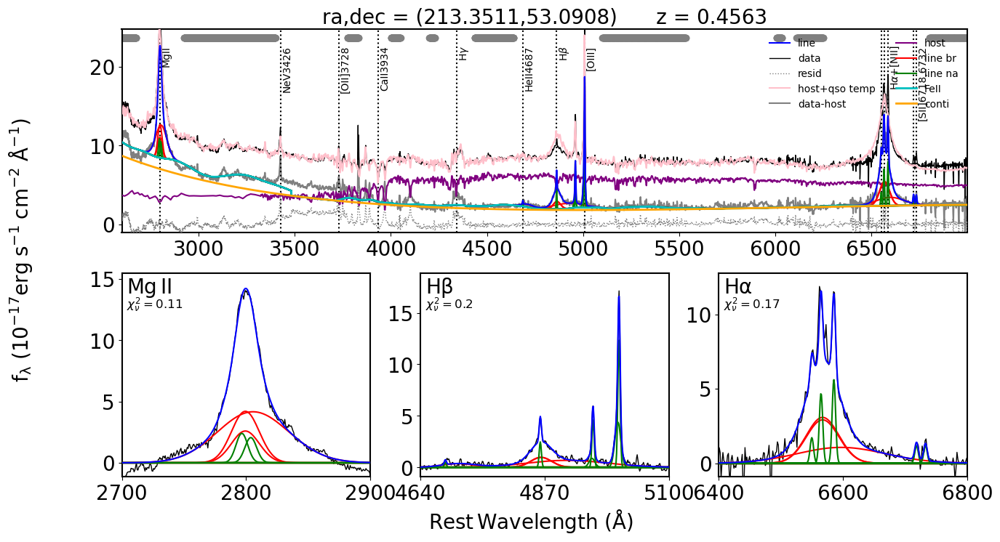

In [7]:
path_out = os.path.join(pyqsofit.__path__[0], '../', 'example/data/RM017_result')

# Requried
data = fits.open(os.path.join(norm_path, name+'.fits'))
lam = np.logspace(np.log10(3600.),np.log10(3600.)+1.e-4*4649,4650)        # OBS wavelength [A]
flux = data[2].data[0,:]             # OBS flux [erg/s/cm^2/A]
err = data[2].data[1,:]   # 1 sigma error
z = data[1].header['z']                # Redshift


# Optional
ra = data[1].header['RA']        # RA
dec = data[1].header['DEC']      # DEC

# get data prepared 
q0 = QSOFit(lam, flux, err, z, ra=ra, dec=dec, path = path_ex)
np.savetxt(os.path.join(norm_path, 'mean.txt'),np.c_[lam,flux,err])
wave_range=np.array([2600,7000]) #remove the edges

# one important note set FWHM of Fe II to 3000 km/s in the source code to improve the fitting!
# do the fitting
# TODO: BC03 will fail on this fitting!!!

np.random.seed(1027)
q0.Fit(name=None, nsmooth=1, deredden=True, reject_badpix=False, wave_range=wave_range, \
          wave_mask=None, decompose_host=True, host_prior=False, decomp_na_mask=False,host_line_mask=False, 
          npca_gal=5, npca_qso=10, qso_type='CZBIN1',host_type='BC03',Fe_uv_op=True,\
          poly=True, BC=False, rej_abs_conti=False, rej_abs_line=False, linefit=True, save_result=True, save_fig=False, \
          kwargs_plot={'save_fig_path':'.', 'broad_fwhm':1200}, save_fits_path=path_out, verbose=False)


#get the mean param L5100, L3000, BL_mean, host, which will be used later.
Mean_L5100 = float( q0.all_result[np.argwhere(q0.all_result_name == 'L5100')] )
Mean_L3000 = float( q0.all_result[np.argwhere(q0.all_result_name == 'L3000')] )
BL_mean = m.interp(q0.wave,q0.line_flux-q0.f_line_narrow_model,z=q0.z)
host = m.interp(q0.wave*(1+z),q0.host/(1+z))


### 4. Fit the host component with pPXF

Emission lines included in gas templates:
['Hgamma' 'Hbeta' 'HeII4687' '[OIII]5007_d']
(M*/L)_r: 2.591


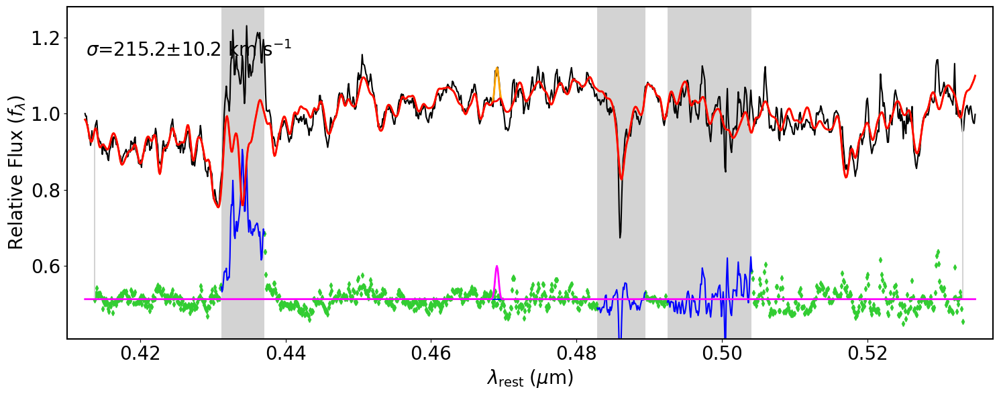

In [8]:
f=interpolate.interp1d(q0.wave_prereduced,q0.flux_prereduced,bounds_error=False,fill_value=0.)
flux_total = f(q0.wave)
host1 = flux_total-q0.qso  #
host2 = flux_total-q0.f_conti_model-q0.f_line_model # better

m.ppxf_host(q0.wave,host2,q0.err,redshift = q0.z, wv_min = 4125, wv_max = 5350, plot = True, quiet = True, mask_width = 2000)


### 5. Fix the narrow emission lines and fit the nightly spectra

In [9]:
fitdata = {key:data for key, data in zip(q0.line_result_name, q0.line_result)}
new_hdu1 = m.fixNL(hdu1, fitdata)
hdu_list = fits.HDUList([primary_hdu, new_hdu1, hdu2, hdu3, hdu4])
hdu_list.writeto(os.path.join(path_ex, 'qsopar.fits'), overwrite=True)
#print '-------'
print(new_hdu1.data)

[(6564.61, 'Ha', 6400., 6800., 'Ha_br', 3,  0.        , 0., 1.e+10, 0.005     , 0.004  , 0.05   , 0.01 , 0, 0, 0, 0.05 , 1)
 (6564.61, 'Ha', 6400., 6800., 'Ha_na', 1,  4.7070956 , 0., 1.e+10, 0.00042293, 0.00023, 0.00169, 0.001, 1, 1, 0, 0.002, 0)
 (6549.85, 'Ha', 6400., 6800., 'NII6549', 1,  1.7167517 , 0., 1.e+10, 0.00042293, 0.00023, 0.00169, 0.005, 1, 1, 0, 0.001, 0)
 (6585.28, 'Ha', 6400., 6800., 'NII6585', 1,  5.6092362 , 0., 1.e+10, 0.00042293, 0.00023, 0.00169, 0.005, 1, 1, 0, 0.003, 0)
 (6718.29, 'Ha', 6400., 6800., 'SII6718', 1,  1.1685802 , 0., 1.e+10, 0.00042293, 0.00023, 0.00169, 0.005, 1, 1, 2, 0.001, 0)
 (6732.67, 'Ha', 6400., 6800., 'SII6732', 1,  1.1685802 , 0., 1.e+10, 0.00042293, 0.00023, 0.00169, 0.005, 1, 1, 2, 0.001, 0)
 (4862.68, 'Hb', 4640., 5100., 'Hb_br', 3,  0.        , 0., 1.e+10, 0.005     , 0.004  , 0.05   , 0.01 , 0, 0, 0, 0.01 , 1)
 (4862.68, 'Hb', 4640., 5100., 'Hb_na', 1,  2.4697223 , 0., 1.e+10, 0.00042071, 0.00023, 0.00169, 0.001, 1, 1, 0, 0.002, 0)


finshed in 137s


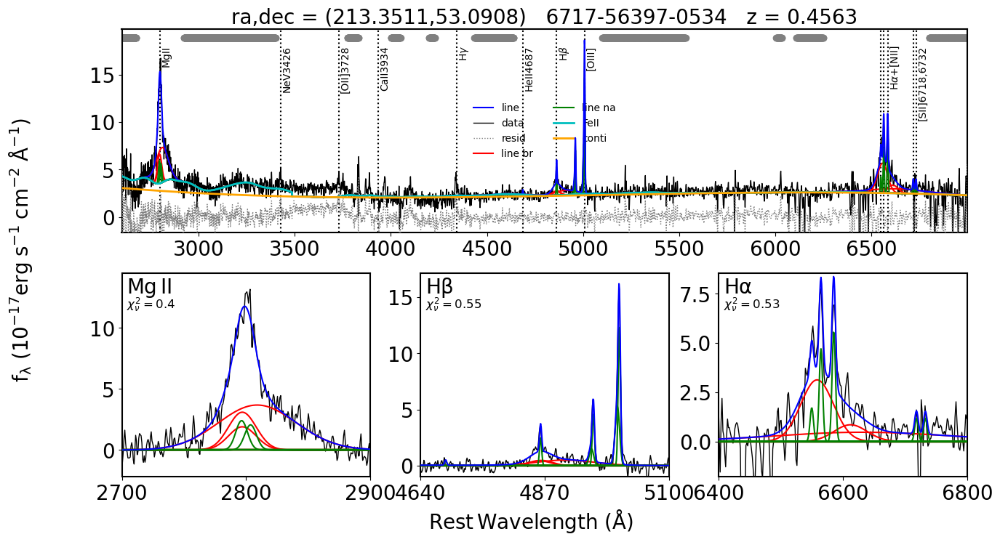

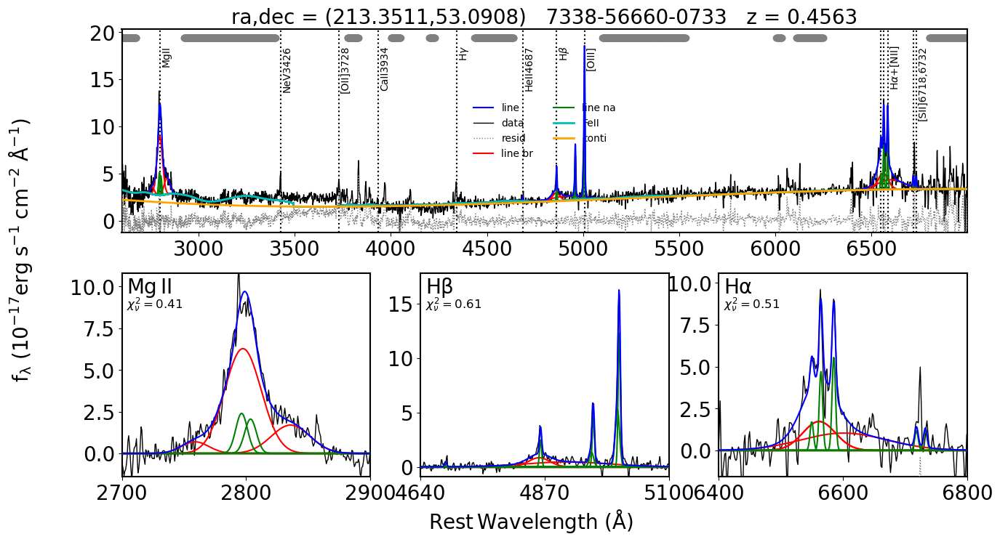

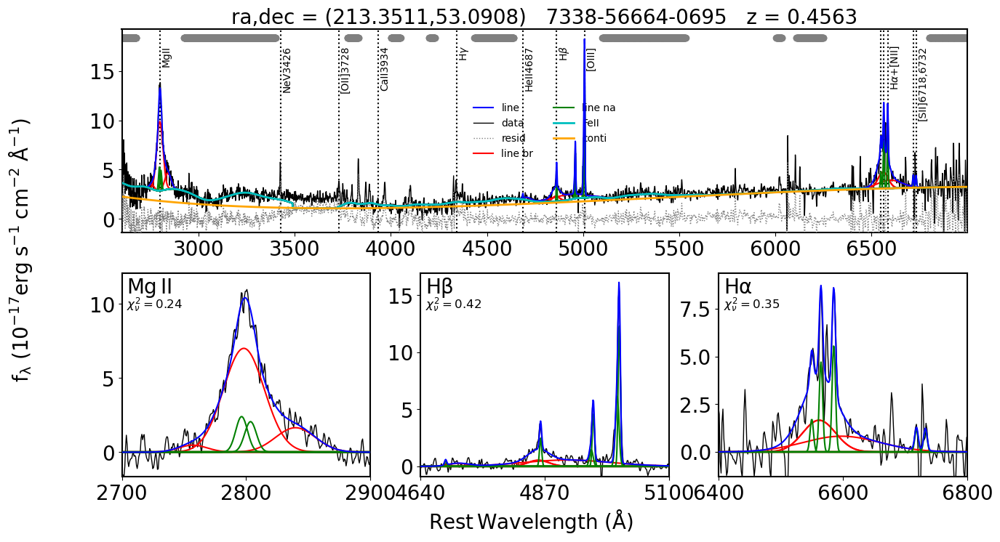

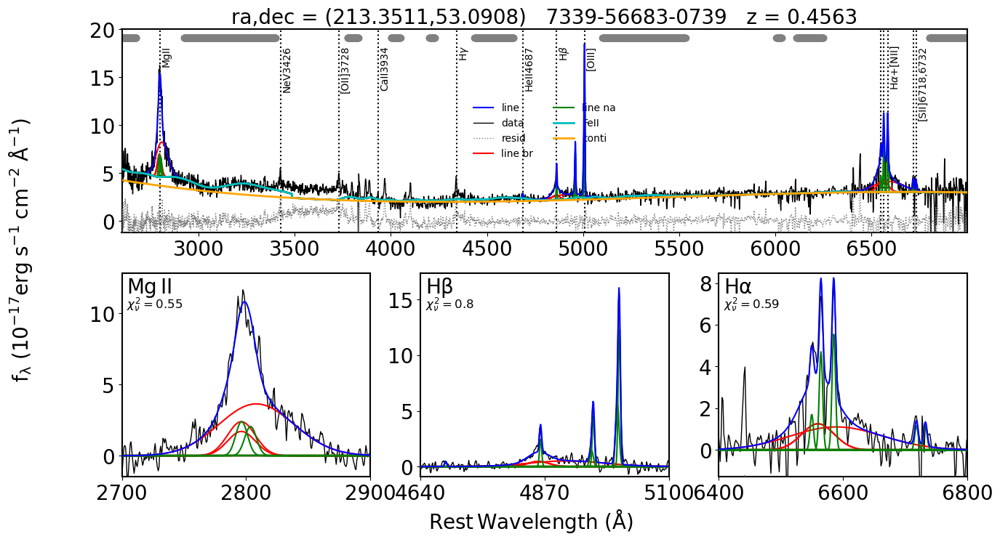

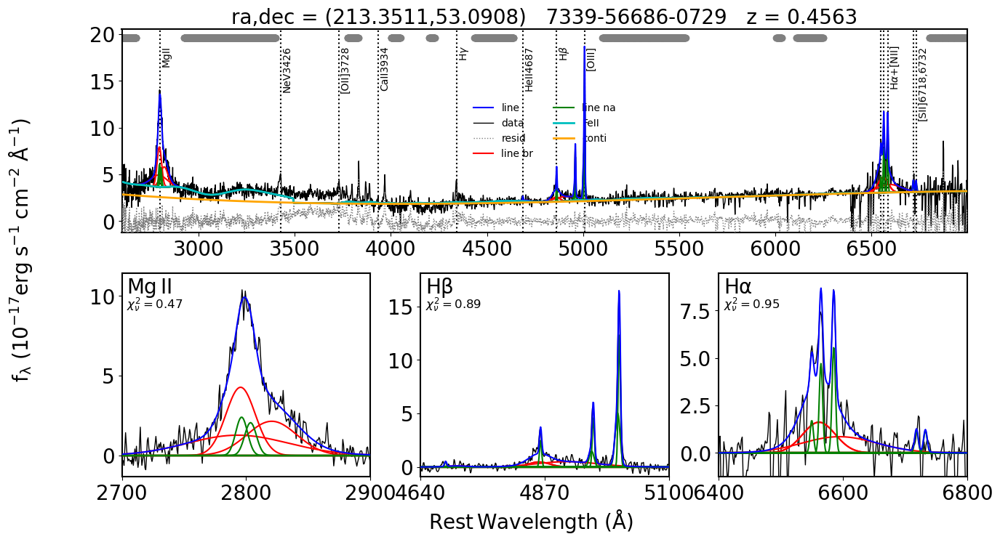

...

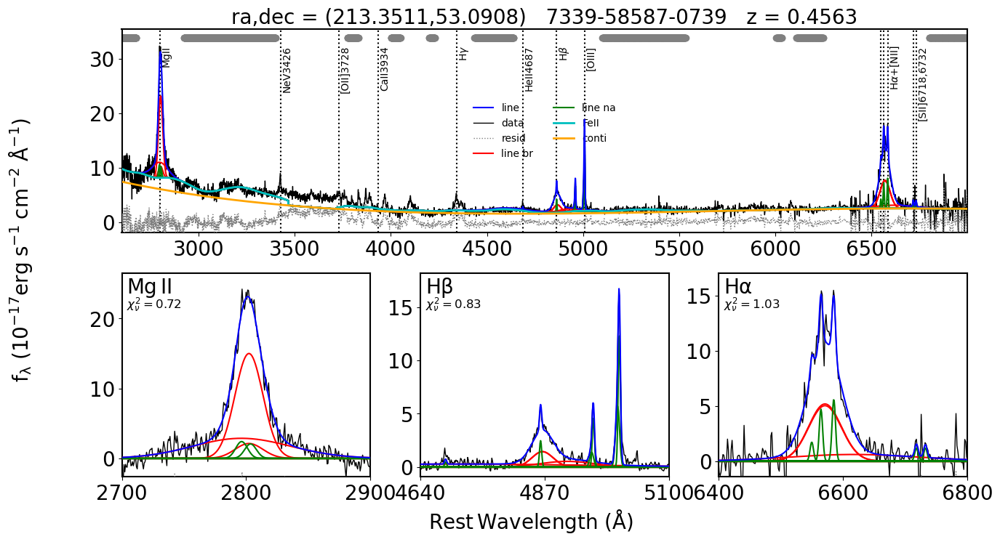

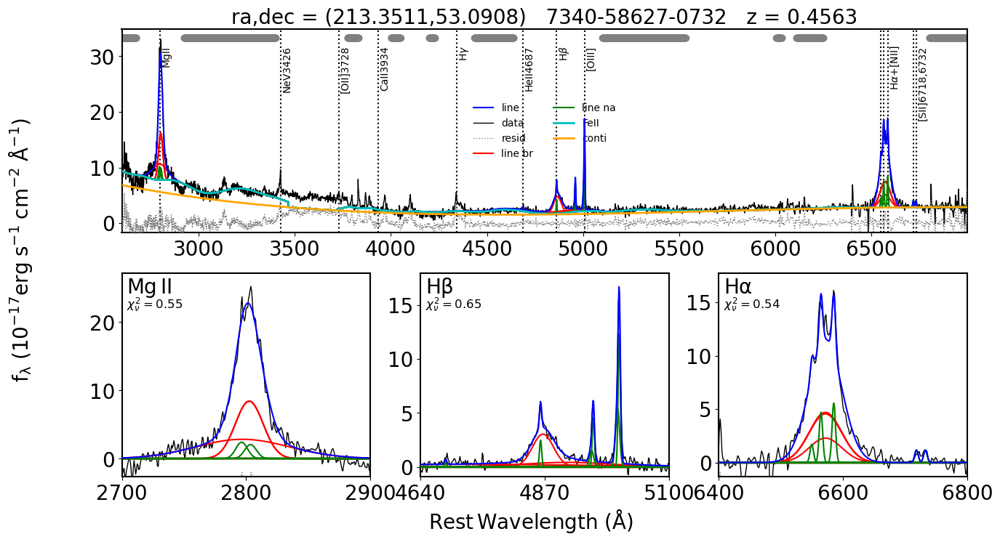

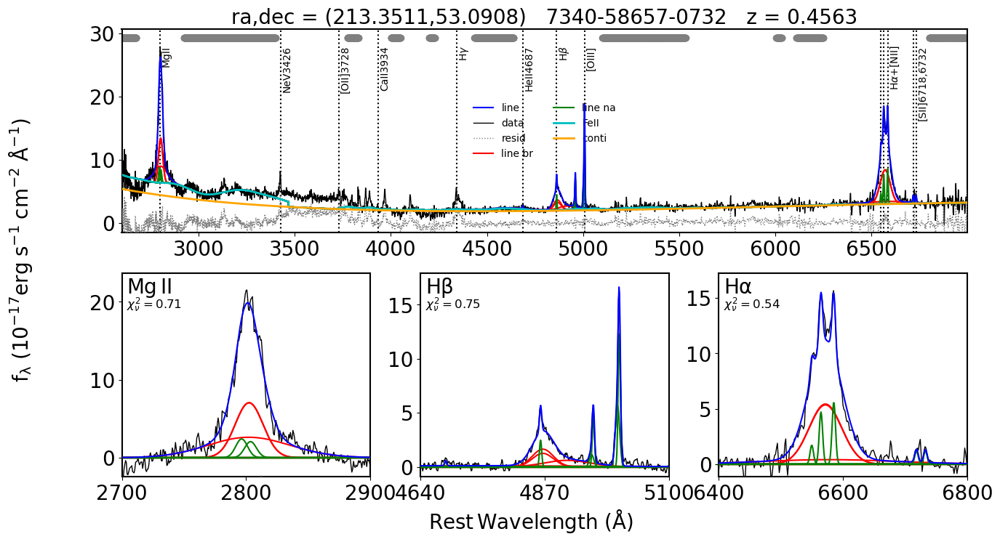

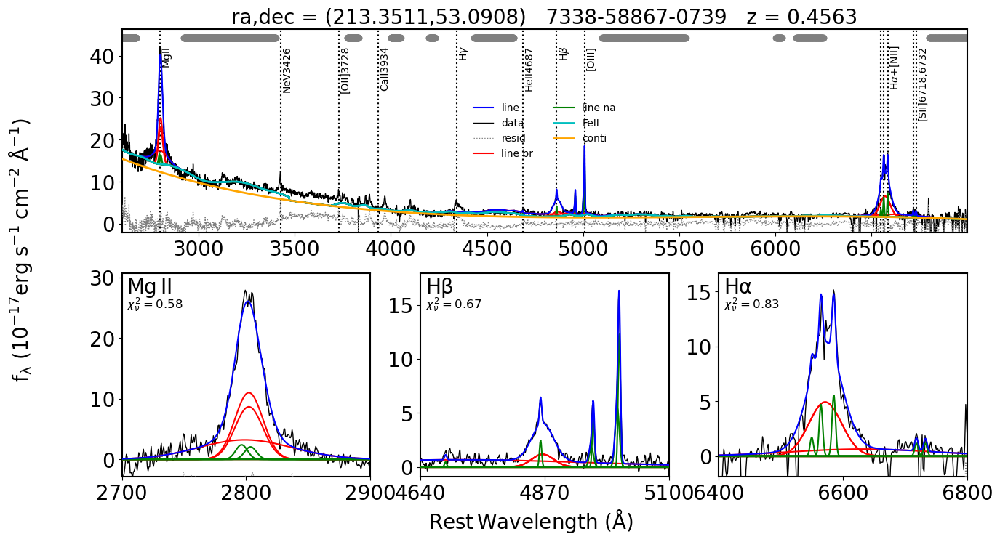

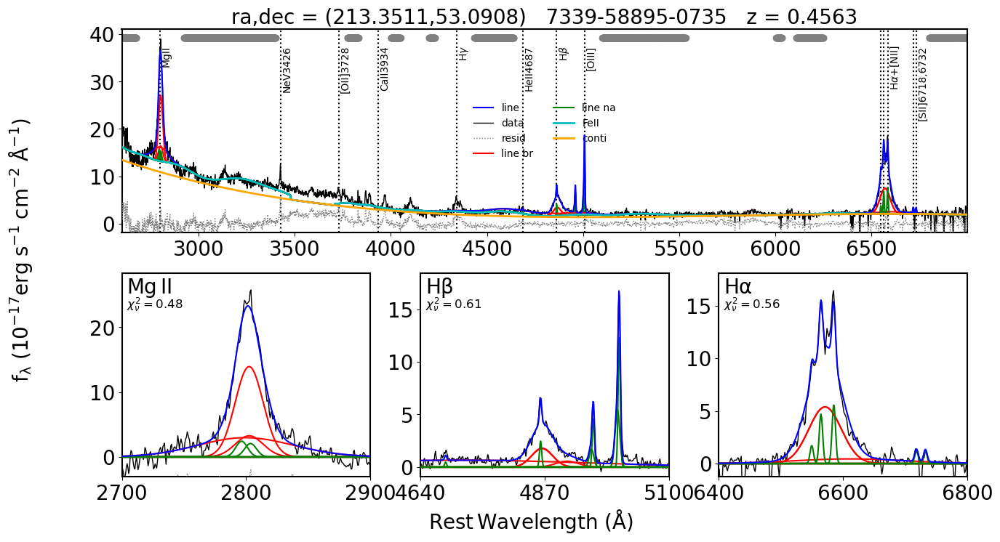

In [10]:
start = timeit.default_timer()

# q0_result = np.concatenate([q0.agn_conti_result, q0.line_result])
# q0_result_name = np.concatenate([q0.agn_conti_result_name, q0.line_result_name])
# res=np.array([]).reshape(0,q0_result.shape[0])
# spec,error,line,BL=[np.array([]).reshape(0,m.mean_wv.shape[0])]*4

res, spec, error, line, BL = [], [], [], [], []

with bpdf.PdfPages(os.path.join(path_out,'all.pdf')) as pdf:
    # The earlest observation is from SDSS instead of BOSS, which only cover a range of 3800-9200A, we skip it here.
#     for i in range(1, 10): 
    for i in range(1, len(data[3].data)): 
        flux_raw=data[3].data[i,:]
        flux=flux_raw-host
        err=data[4].data[i,:]
        plate = data[1].data['plate'][i]
        mjd = data[1].data['mjd'][i]
        fiber = data[1].data['fiber'][i]
        ra = data[1].header['ra']
        dec = data[1].header['dec']
        # get data prepared 
        q = QSOFit(lam, flux, err, z, ra=ra,dec=dec,plateid=plate, mjd=mjd,fiberid=fiber, path = path_ex)
        
        # do the fitting

        q.Fit(name=None, nsmooth=1, deredden=True, reject_badpix=False, wave_range=wave_range, 
              wave_mask=None, decompose_host=False, host_prior=True, decomp_na_mask=True, npca_gal=5, npca_qso=10, qso_type='CZBIN1', Fe_uv_op=True,
              poly=True, BC=False, rej_abs_conti=False, rej_abs_line=False, linefit=True, save_result=True, save_fig=False, 
              kwargs_plot={'save_fig_path':'.', 'broad_fwhm':1200}, save_fits_path=path_out, verbose=False)
        

        #stack the results into 1 file
#         res=np.vstack((res,q.all_result))
#         spec=np.vstack((spec,m.interp(q.wave,q.flux,z=q.z)))
#         error=np.vstack((error,m.interp(q.wave,q.err,z=q.z)))
#         line=np.vstack((line,m.interp(q.wave,q.line_flux,z=q.z)))
        
        res.append(q.all_result)
        spec.append(m.interp(q.wave,q.flux,z=q.z))
        error.append(m.interp(q.wave,q.err,z=q.z))
        line.append(m.interp(q.wave,q.line_flux,z=q.z))
        
        # delete the broad HeII
        indheii = np.where(q.all_result_name == 'HeII4687_br_1_scale')[0][0]
        heii_flux = q.Onegauss(np.log(q.wave),m.s2f(q.all_result[indheii:indheii+3]))
#         BL=np.vstack((BL, m.interp(q.wave,q.line_flux-q.f_line_narrow_model-heii_flux,z=q.z)))
        BL.append(m.interp(q.wave,q.line_flux-q.f_line_narrow_model-heii_flux,z=q.z))
        pdf.savefig(q.fig)

res = np.array(res)
spec = np.array(spec)
error = np.array(error)
line = np.array(line)
BL = np.array(BL)
        
t = Table(res, names = (q.all_result_name))
t.write(os.path.join(path_out,'MESFit_results.fits'), format = 'fits', overwrite = True) 

for j in ['SPEC','Line','BLflux','Err']:
    hdr2 = fits.Header()
    hdr2['EXTNAME'] = j
    hdr2['COEEF0'] = (np.log10(3600.), 'Central wavelength (log10) of first pixel')
    hdr2['COEEF1'] = (0.0001 , 'Log10 dispersion per pixel')
    hdr2['NPIXEL'] = (4650 , 'Pixel number of wavelength')
    if j == 'SPEC':
        hdr2['flux'] = ('flux', 'rest AGN flux with/without deredden and dehost, erg/s/cm^2/A')
        fits.append(filename= os.path.join(path_out,'MESFit_results.fits'), data=spec,header=hdr2)
    if j == 'Line':
        hdr2['lineflux'] = ('lineflux', 'Broad line + Narrow line, erg/s/cm^2/A')
        fits.append(filename= os.path.join(path_out,'MESFit_results.fits'), data=line,header=hdr2)
    if j == 'BLflux':
        hdr2['BLflux'] = ('BLflux','line flux - narrow line model, erg/s/cm^2/A')
        fits.append(filename= os.path.join(path_out,'MESFit_results.fits'), data=BL,header=hdr2)
    if j == 'Err':
        hdr2['err'] = ('err','spec err, erg/s/cm^2/A')
        fits.append(filename= os.path.join(path_out,'MESFit_results.fits'), data=error,header=hdr2)

end = timeit.default_timer()
print('finshed in '+str(round(end-start))+'s')

### 6 plot the continuum and emission line light curves

Text(0.5, 0, '$\\rm MJD$')

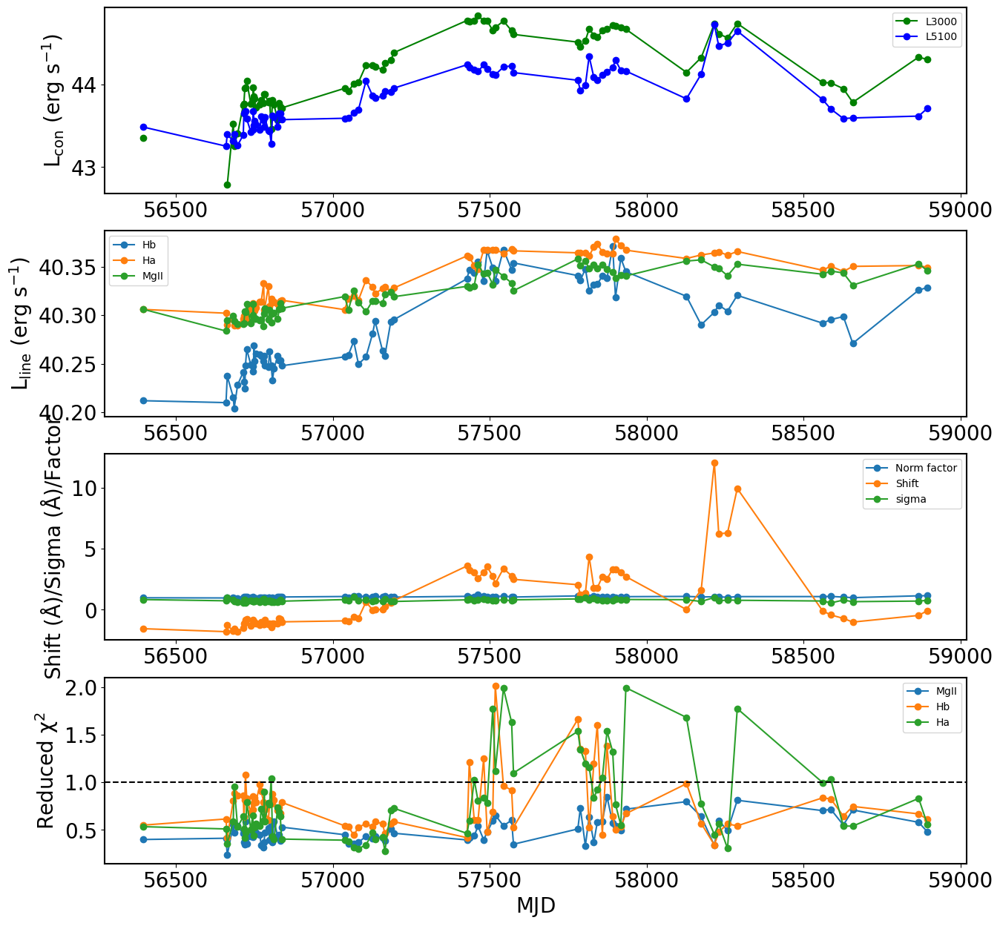

In [11]:

d=fits.open(os.path.join(path_out,'MESFit_results.fits'))[1].data
norm = fits.open(os.path.join(path_out, 'table.fits'))[1].data

mjd = m.s2f(d['mjd'])
l5100 = m.s2f(d['L5100'])
l3000 = m.s2f(d['L3000'])


plt.figure(figsize=(15,15))
plt.subplot(411)
L3000=np.log10(10**np.array(l3000)+m.flux2L(norm['shift'][1:]*3000.,z))
L5100=np.log10(10**np.array(l5100)+m.flux2L(norm['shift'][1:]*5100.,z))

plt.plot(mjd,L3000, 'go-',label='L3000')
plt.plot(mjd,L5100, 'bo-',label='L5100')
plt.legend(loc='best')
plt.ylabel(r'$\rm L_{\rm con}\ (erg\ s^{-1})$')

plt.subplot(412)
plt.plot(mjd,np.log10(m.flux2L(np.log10(m.s2f(d['Hb_whole_br_area'])),z)),'o-',label='Hb')
plt.plot(mjd,np.log10(m.flux2L(np.log10(m.s2f(d['Ha_whole_br_area'])),z)),'o-',label='Ha')
plt.plot(mjd,np.log10(m.flux2L(np.log10(m.s2f(d['MgII_whole_br_area'])),z)),'o-',label='MgII')
plt.ylabel(r'$\rm L_{\rm line}\ (erg\ s^{-1})$')

plt.legend(loc='best')

plt.subplot(413)
plt.plot(mjd, norm['factor'][1:],'o-',label='Norm factor')
plt.plot(mjd, norm['shift'][1:],'o-',label='Shift')
plt.plot(mjd, norm['sigma'][1:],'o-',label='sigma')
plt.legend(loc='best')
plt.ylabel(r'$\rm Shift\ (\AA)/ Sigma\ (\AA) /Factor$')

plt.subplot(414)
plt.plot(mjd,m.s2f(d['1_line_red_chi2']), 'o-',label=d['1_complex_name'][0])
plt.plot(mjd,m.s2f(d['2_line_red_chi2']), 'o-',label=d['2_complex_name'][0])
plt.plot(mjd,m.s2f(d['3_line_red_chi2']), 'o-',label=d['3_complex_name'][0])
plt.axhline(1, c='k', ls='--')
plt.legend(loc='best')
plt.ylabel(r'$\rm Reduced\ \chi^2$')
plt.xlabel(r'$\rm MJD$')

### 7 Obtain the emission line only rms spectrum

1816.2 1377.8


Text(6500, 0.9, '$\\sigma$ = 1015.8$\\rm \\ km\\ s^{-1}$')

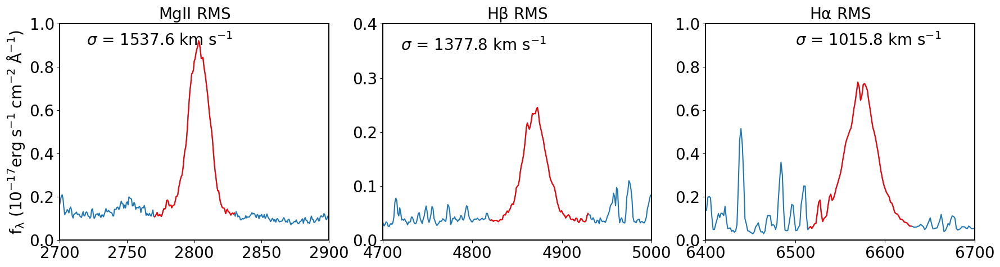

In [9]:
mesfit=fits.open(os.path.join(path_out,'MESFit_results.fits'))
bl=mesfit[4].data
err=mesfit[5].data
spec=mesfit[2].data
shift_hb=np.array([])
shift_oiii=np.array([])
shift_ha=np.array([])
shift_mgii=np.array([])
SNline = np.array([])
mjd=mesfit[1].data['mjd']

flux_all = np.zeros_like(m.mean_wv)
c= 0
for i in range(bl.shape[0]):
    c=c+1
    #plt.plot(m.mean_wv, spec[i,:])
    flux_all = flux_all+(bl[i,:]-BL_mean)**2
fig=plt.figure(figsize=(21,5))
plt.errorbar(m.mean_wv,np.sqrt(flux_all)/c,yerr=m.rms_err,color='gray',elinewidth=0.,capthick=0,capsize=0,alpha=0.1)

rms2_spec=np.sqrt(flux_all)/c

plt.subplot(131)

plt.plot(m.mean_wv,rms2_spec)
plt.xlim(2700,2900)
plt.ylim(-0.,1)
plt.ylabel(r'$\rm f_{\lambda}$ ($\rm 10^{-17} erg\;s^{-1}\;cm^{-2}\;\AA^{-1}$)')
plt.title(r'$\rm MgII\ RMS$')
ind=np.where( (m.mean_wv < 2830) & (m.mean_wv>2770),True,False )
plt.plot(m.mean_wv[ind],rms2_spec[ind],'r')
fwhm_MgII, sigma_MgII = m.Calwidth(m.mean_wv,rms2_spec, wv_min = 2760,wv_max=2830)
plt.text(2720,0.9,r'$\sigma$ = '+ str(sigma_MgII)+r'$\rm \ km\ s^{-1}$', fontsize =20)
#plt.plot(m.mean_wv,(m.rms_spec-1)*1.8)

plt.subplot(132)
plt.plot(m.mean_wv,rms2_spec)
plt.xlim(4700,5000)
plt.ylim(-0.0,.4)
plt.title(r'$\rm H\beta\ RMS$')
ind=np.where( (m.mean_wv < 4930) & (m.mean_wv>4820),True,False )
plt.plot(m.mean_wv[ind],rms2_spec[ind],'r')
fwhm_Hb, sigma_Hb = m.Calwidth(m.mean_wv,rms2_spec, wv_min = 4820,wv_max=4930)
plt.text(4720,0.35,r'$\sigma$ = '+ str(sigma_Hb)+r'$\rm \ km\ s^{-1}$', fontsize =20)
#plt.plot(m.mean_wv,(m.rms_spec-0.22)*1.8)
print(fwhm_Hb,sigma_Hb)

plt.subplot(133)

plt.plot(m.mean_wv,rms2_spec)
plt.xlim(6400,6700)
plt.ylim(-0.,1)
plt.title(r'$\rm H\alpha\ RMS$')
ind=np.where( (m.mean_wv < 6630) & (m.mean_wv>6515),True,False )
plt.plot(m.mean_wv[ind],rms2_spec[ind],'r')
fwhm_Ha, sigma_Ha = m.Calwidth(m.mean_wv,rms2_spec, wv_min = 6515,wv_max=6630)
plt.text(6500,0.9,r'$\sigma$ = '+ str(sigma_Ha)+r'$\rm \ km\ s^{-1}$', fontsize =20)
#plt.plot(m.mean_wv,(m.rms_spec-0.1)*1.5)


####  7.1 Calculate the black hole mass

Following the equation:
$$
M_{BH} = \frac{fR_{BLR}\Delta V^2}{G},
$$
combining the time lag given by [Grier et al. (2017)](https://iopscience.iop.org/article/10.3847/1538-4357/aa98dc), we can caluclate the $M_{BH}$ measurements. 
For $H\alpha$, the referencing time lag $\tau_{final}=56.6$ days. 
For $H\beta$, the referencing time lag $\tau_{final}=25.5$ days. 
We adopt the scale factor $f=4.47$ from [Woo et al. (2015)](https://doi.org/10.1088/0004-637X/801/1/38).

In [10]:
from astropy import constants as const
from astropy import units as u
tau_Ha = 56.6 * u.day
tau_Hb = 25.5 * u.day
f_sig = 4.47

M_BH = lambda sigma, tau: f_sig*tau*const.c*sigma**2/const.G

M_BH_Ha = M_BH(sigma_Ha * u.km / u.s, tau_Ha)
M_BH_Hb = M_BH(sigma_Hb * u.km / u.s, tau_Hb)

print(f'M_BH,Ha = {M_BH_Ha.to(u.Msun).value/1e7:.2f} * 1e7 Msun')
print(f'M_BH,Hb = {M_BH_Hb.to(u.Msun).value/1e7:.2f} * 1e7 Msun')

M_BH,Ha = 5.10 * 1e7 Msun
M_BH,Hb = 4.22 * 1e7 Msun
